# <h1 align="center">COSC2753 - Machine Learning</h1>

<h2 align="center">Group Machine Learning Project</h2>

---

### 👥 Group Members:
- Ngo Van Tai (S3974892)  
- Huynh Thai Duong (S)
- Huynh Tan Phat (S)
- Duong Minh Tri (S)

---


# CONVENTIONAL RULE

- Tất cả tên biến đều là snake case (variable_one)
- Tất cả function đều phải có docstring (có thể nhờ GPT rồi parapharse lại)
- Tất cả import library thì phải được đặt ở đầu file với comment rõ ràng vào cái phần của nó (ở chỗ import neccessary librariess)
- Hàm nào lặp lại quá nhiều lần thì phải define helper function (cùng với docstring) of course

# TABLE OF CONTENT

# IMPORT NECESSARY LIBRARIES

In [2]:
# Data manipulation libraries
import pandas as pd
import numpy as np
import random
import cv2
import os
from tqdm import tqdm
from collections import defaultdict
import imagehash
from PIL import Image

# Data visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Image Visualization
import matplotlib.image as mpimg


# Machine learning models
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor

# Model preprocessing and evaluation
from scipy.stats.mstats import winsorize
from sklearn.impute import SimpleImputer

from sklearn.model_selection import (
    train_test_split,
    KFold,
    GridSearchCV,
)
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.metrics import (
    mean_squared_error,
    r2_score,
    mean_absolute_error,
)

## 1) Define Some Helper Functions

In [3]:
def print_header(content, padding=10, width=None, tabs=False):
    """
    Prints a header wrapped inside a box.

    Parameters:
    - content: Text to display as header (automatically uppercase)
    - padding: Spaces on each side of the content inside the box
    - width: Optional fixed width for the entire box. If None, adjusts to content size.
    - tabs: If true, adds the spacing `\t`to center of the box
    """
    content = content.upper()
    inner_width = len(content) + (padding * 2)
    box_width = width if width and width > inner_width else inner_width

    top_bottom = "+" + "-" * (box_width + 2) + "+"
    padded_content = "| " + content.center(box_width) + " |"
    prefix = "\t" * 3 if tabs else ""

    print(f"{prefix}{top_bottom}")
    print(f"{prefix}{padded_content}")
    print(f"{prefix}{top_bottom}")

In [4]:
def display_images_from_paths(
    image_paths, metadata_df=None, title=None, figsize=(15, 3)
):

    num_images = len(image_paths)
    fig, axes = plt.subplots(1, num_images, figsize=figsize, facecolor="white")

    if num_images == 1:
        axes = [axes]

    for idx, file_path in enumerate(image_paths):
        filename = os.path.basename(file_path)
        img_title = filename

        if metadata_df is not None and "image_id" in metadata_df.columns:
            img_data = metadata_df[metadata_df["image_id"] == filename]
            if not img_data.empty:
                title_parts = [f"ID: {filename}"]
                for col in img_data.columns:
                    if col != "image_id":
                        title_parts.append(f"{col}: {img_data[col].values[0]}")
                img_title = "\n".join(title_parts)

        try:
            img = mpimg.imread(file_path)
            axes[idx].imshow(img)
            axes[idx].axis("off")
            axes[idx].set_title(img_title, fontsize=9)
        except FileNotFoundError:
            print(f"Image not found: {file_path}")

    if title:
        plt.suptitle(title, fontsize=14, y=1.01)
        plt.subplots_adjust(top=0.85)

    plt.tight_layout()
    plt.show()

# II. LOAD DATASET

## 1. Loading Dataset

In [5]:
df = pd.read_csv('./inputs/meta_train.csv')

# III. EXPLORATORY DATA ANALYSIS (EDA)

## 1) Dataset Overview

We can see that there are 4 columns inside the dataset:

| Column Name | Description |
|-------------|-------------|
| `image_id`  | Unique identifier for each image, matching the file names (.jpg) in the `train_images` directory |
| `label`     | The category of paddy disease. There are ten classes, including one for healthy (normal) plant |
| `variety`   | The paddy variety name |
| `age`       | The age of the paddy in days |

In [6]:
print_header('Dataset Overview')
df

+--------------------------------------+
|           DATASET OVERVIEW           |
+--------------------------------------+


,image_id,label,variety,age
0,100330.jpg,bacterial_leaf_blight,ADT45,45
1,100365.jpg,bacterial_leaf_blight,ADT45,45
2,100382.jpg,bacterial_leaf_blight,ADT45,45
3,100632.jpg,bacterial_leaf_blight,ADT45,45
4,101918.jpg,bacterial_leaf_blight,ADT45,45
...,...,...,...,...
10402,107607.jpg,tungro,Zonal,55
10403,107811.jpg,tungro,Zonal,55
10404,108547.jpg,tungro,Zonal,55
10405,110245.jpg,tungro,Zonal,55


## 2) Data Shape

In the initial observation, the given dataset contains over 10,000 rows,and four different column.

In [7]:
print_header("Data Shape")

print("Number of Rows: ", df.shape[0])
print("Number of Columns: ", df.shape[1])

+--------------------------------+
|           DATA SHAPE           |
+--------------------------------+
Number of Rows:  10407
Number of Columns:  4


## 3) Duplicated & Null Data

There is no duplicated or null data appearing in the given dataset. However, we need to compute image hashes to identify any duplicate images.

In [8]:
print_header('Missing Data')
df.isnull().sum()

+----------------------------------+
|           MISSING DATA           |
+----------------------------------+


image_id    0
label       0
variety     0
age         0
dtype: int64

In [9]:
print_header('Duplicated Data')
df.duplicated().sum()

+-------------------------------------+
|           DUPLICATED DATA           |
+-------------------------------------+


0

### Compute Image Hash

To identify duplicate images in the dataset, we used the `imagehash` library, especially the [`phash`](https://johannesbuchner.github.io/imagehash/art3.html) (perceptual hash) function. This function generates a hash value for each image, allowing us to detect duplicates.

After scanning through the dataset, we identified 180 duplicate sets, where each set contains at least two visually identical images. 

These duplicates must be handled properly, as they will cause bias during the training process. In this project, with the large original dataset, we will remove all duplicate images and keep only the first image from each duplicate set.

In [ ]:
# Directory to scan
img_directory = "./inputs/train_images"
# Choose hash function
hash_fn = imagehash.phash

# Store hash, list of file paths
hash_dict = defaultdict(list)

for label in tqdm(os.listdir(img_directory), desc="Scanning folders"):
    label_dir = os.path.join(img_directory, label)
    if not os.path.isdir(label_dir):
        continue

    for file in tqdm(os.listdir(label_dir), desc=f"Processing {label}", leave=False):
        img_path = os.path.join(label_dir, file)

        try:
            img = Image.open(img_path).convert("RGB")
            h = str(hash_fn(img))  # Convert hash to string
            hash_dict[h].append(img_path)
        except Exception as e:
            print(f"[ERROR] {img_path}: {e}")


# Find duplicates
duplicate_sets = {h: ps for h, ps in hash_dict.items() if len(ps) > 1}

print_header("Duplicated data")
print(f"\nFound {len(duplicate_sets)} sets of duplicate images.")

Scanning folders: 100%|██████████| 11/11 [00:36<00:00,  3.35s/it]

+-------------------------------------+
|           DUPLICATED DATA           |
+-------------------------------------+

Found 180 sets of duplicate images.


+--------------------------------------------------------------+
|           DUPLICATE SET #1 (HASH=87D6B8CE0AA50DD3)           |
+--------------------------------------------------------------+


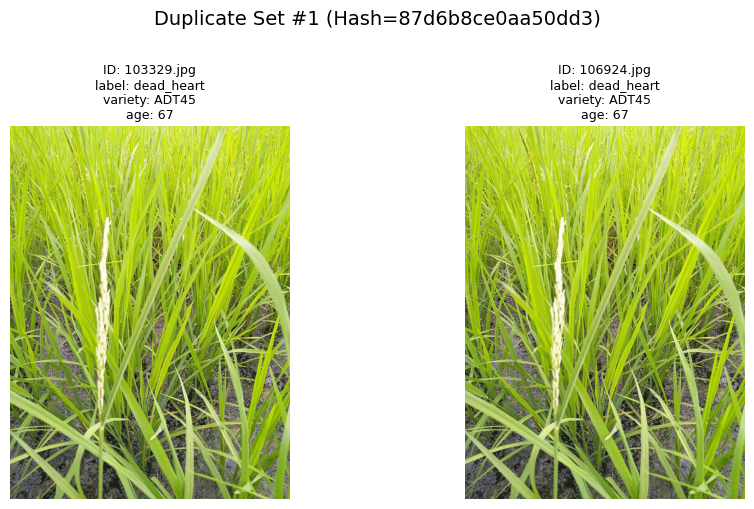

+--------------------------------------------------------------+
|           DUPLICATE SET #2 (HASH=D8A352DE3FC01A96)           |
+--------------------------------------------------------------+


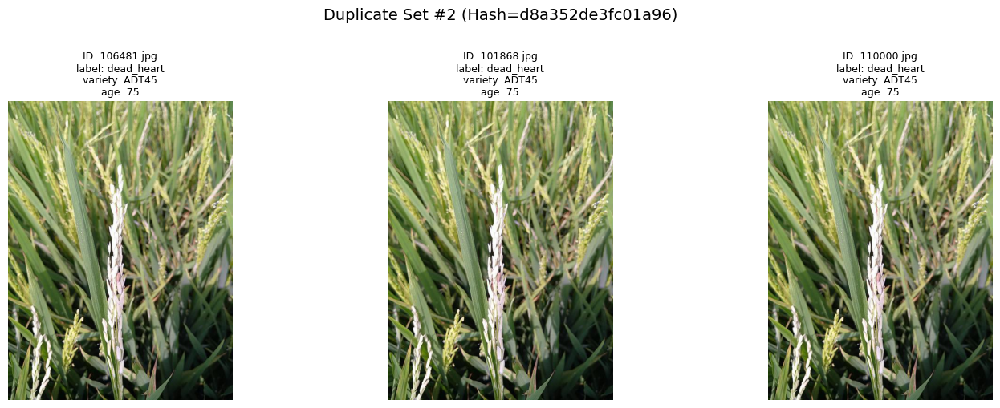

+--------------------------------------------------------------+
|           DUPLICATE SET #3 (HASH=F892E62A55E00AFD)           |
+--------------------------------------------------------------+


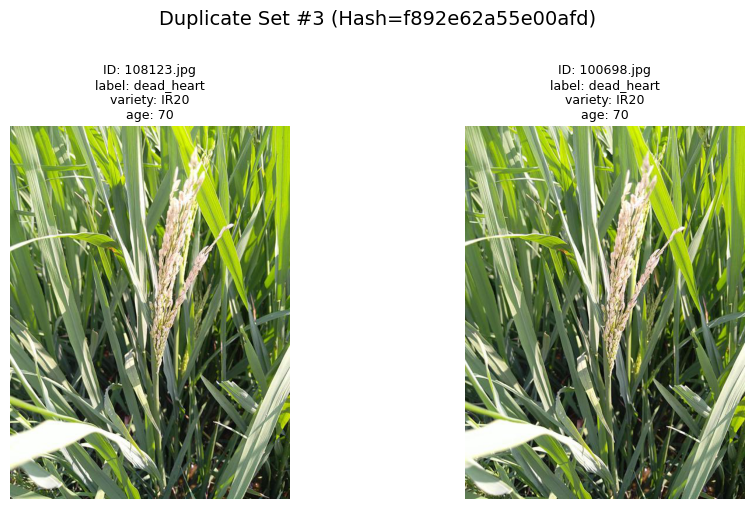

+--------------------------------------------------------------+
|           DUPLICATE SET #4 (HASH=CEC898C827C97D8E)           |
+--------------------------------------------------------------+


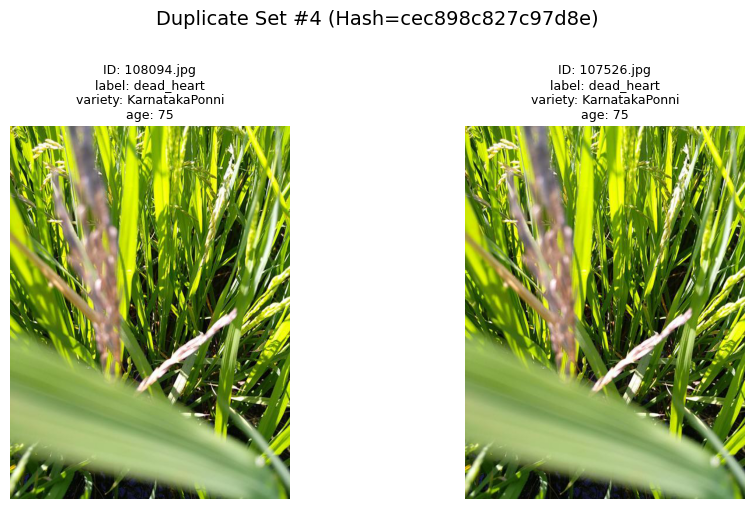

+--------------------------------------------------------------+
|           DUPLICATE SET #5 (HASH=A5D33C914F8D70A3)           |
+--------------------------------------------------------------+


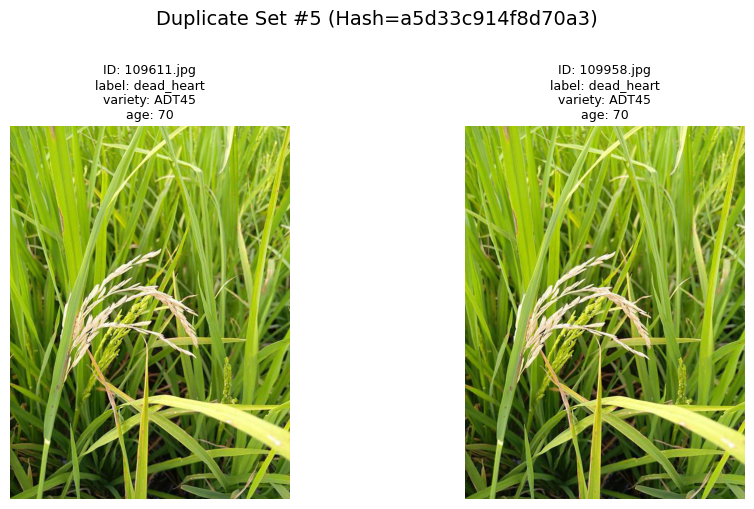

In [11]:
# Loop through first 5 duplicated set
for i, (h, paths) in enumerate(duplicate_sets.items()):
    if i >= 5:
        break

    title = f"Duplicate Set #{i+1} (Hash={h})"
    print_header(title)

    title = f"Duplicate Set #{i+1} (Hash={h})"
    display_images_from_paths(
        image_paths=paths, metadata_df=df, title=title, figsize=(5 * len(paths), 5)
    )

In [14]:
def remove_duplicated_images(
    df, duplicate_sets, output_path="./inputs/meta_train_clean.csv"
):
    """
    Removes duplicated images from the original dataset

    Parameters:
    - df: Dataframe of metadata
    - duplicated_sets: Dictionary mapping hashes to lists of duplicated images path
    - output_path: The path for output csv file
    """

    # copy the original df
    df_clean = df.copy()

    images_to_remove = []
    kept_images = []

    print_header("Duplicate Removal Process")

    for hash_val, image_paths in duplicate_sets.items():
        # keep the first image
        keep_path = image_paths[0]
        keep_filename = os.path.basename(keep_path)

        # keep track the kept images
        kept_images.append(
            {
                "hash": hash_val,
                "kept_image": keep_filename,
                "kept_path": keep_path,
                "duplicate_count": len(image_paths) - 1,
            }
        )

        # Remove the rest of the duplicate images
        for remove_path in image_paths[1:]:
            remove_filename = os.path.basename(remove_path)
            images_to_remove.append(
                {
                    "hash": hash_val,
                    "removed_image": remove_filename,
                    "removed_path": remove_path,
                    "kept_image": keep_filename,
                }
            )

    kept_df = pd.DataFrame(kept_images)
    removed_df = pd.DataFrame(images_to_remove)

    print(f"Total duplicate sets found: {len(duplicate_sets)}")
    print(f"Total images being removed: {len(images_to_remove)}")

    image_ids_to_remove = [
        os.path.basename(path) for path in removed_df["removed_path"]
    ]

    # Filter out the removed images from the DataFrame
    df_clean = df_clean[~df_clean["image_id"].isin(image_ids_to_remove)]

    # Save the cleaned DataFrame
    df_clean.to_csv(output_path, index=False)

    print(f"\nRemoved {len(df) - len(df_clean)} duplicate entries from CSV")
    print(f"Updated CSV saved to: {output_path}")

In [15]:
remove_duplicated_images(df,duplicate_sets)

+-----------------------------------------------+
|           DUPLICATE REMOVAL PROCESS           |
+-----------------------------------------------+
Total duplicate sets found: 180
Total images being removed: 199

Removed 199 duplicate entries from CSV
Updated CSV saved to: ./inputs/meta_train_clean.csv


In [17]:
clean_df = pd.read_csv("./inputs/meta_train_clean.csv")
clean_df

,image_id,label,variety,age
0,100330.jpg,bacterial_leaf_blight,ADT45,45
1,100365.jpg,bacterial_leaf_blight,ADT45,45
2,100382.jpg,bacterial_leaf_blight,ADT45,45
3,100632.jpg,bacterial_leaf_blight,ADT45,45
4,101918.jpg,bacterial_leaf_blight,ADT45,45
...,...,...,...,...
10203,107607.jpg,tungro,Zonal,55
10204,107811.jpg,tungro,Zonal,55
10205,108547.jpg,tungro,Zonal,55
10206,110245.jpg,tungro,Zonal,55


In [24]:
print_header("Clean Data Shape")

print("Number of Rows: ", clean_df.shape[0])
print("Number of Columns: ", clean_df.shape[1])

+--------------------------------------+
|           CLEAN DATA SHAPE           |
+--------------------------------------+
Number of Rows:  10208
Number of Columns:  4


## 3) Exploring Columns

### 3.1) Label Column

There are 10 classes in the `label` column, including nine disease classes and one for healthy (normal) plant:

| Class                     | Explanation |
|--------------------------|-------------|
| `bacterial_leaf_blight`  | The bacterial disease results in dark lesions with yellow borders that cause leaf tissue death |
| `bacterial_leaf_streak`  | The bacterial infection results in leaf tissue death through the formation of streaks or lesions |
| `bacterial_panicle_blight` | The bacterial disease targets rice panicle structures by killing flower clusters which leads to decreased grain yields |
| `blast`                  | Blast is a fungal disease that causes dark lesions on leaves, necks, and panicles of rice, and can lead to plant death |
| `brown_spot`             | The disease produces brown circular lesions with yellowish margins on rice leaves which decrease photosynthesis and growth |
| `dead_heart`             | Stem borer infestation leads to this condition when the insect pests damage the plant's growing point which results in stunted growth or plant death |
| `downy_mildew`           | A fungal disease that causes yellowing of leaves with white fungal growth on the undersides, often reducing plant vigor |
| `hispa`                  | The hispa beetle infestation results in damage to rice plants through leaf consumption which leads to yield reduction |
| `normal`                 | This refers to healthy plants without any visible signs of disease or pest damage |
| `tungro`                 | A viral disease transmitted by leafhoppers that causes yellowing and stunting of rice plants, leading to yield loss |


In [19]:
unique_labels = clean_df["label"].nunique()

print_header("Paddy Labels Overview")
print(f"The dataset contains {unique_labels} unique paddy labels.\n")

# Display the list of unique labels
print_header("List of Paddy Labels")
print("Here are the unique paddy varieties in the dataset:")
for idx, label in enumerate(clean_df["label"].unique().tolist(), start=1):
    print(f"{idx}) {label}")

+-------------------------------------------+
|           PADDY LABELS OVERVIEW           |
+-------------------------------------------+
The dataset contains 10 unique paddy labels.

+------------------------------------------+
|           LIST OF PADDY LABELS           |
+------------------------------------------+
Here are the unique paddy varieties in the dataset:
1) bacterial_leaf_blight
2) bacterial_leaf_streak
3) bacterial_panicle_blight
4) blast
5) brown_spot
6) dead_heart
7) downy_mildew
8) hispa
9) normal
10) tungro


### 3.2) Variety Column

| Variety        | Explanation |
|----------------|-------------|
| `ADT45`        | ADT45 is a popular high yielding variety of rice from Tamil Nadu (India), which is known for its excellent grain quality and good resistance to pests and diseases |
| `IR20`         | IR20 is a widely grown rice type developed by the International Rice Research Institute, known for its resistance to drought and its good yield |
| `KarnatakaPonni` | KarnatakaPonni is a traditional rice variety grown in the southern region of India, particularly known for its taste and aroma |
| `Onthanel`     | Onthanel is a variety known for its good cooking qualities and higher resistance to pests, widely cultivated in some parts of India |
| `Ponni`        | Ponni is one of the most famous rice varieties in India, renowned for its smooth texture and aroma, widely used in South Indian cuisine |
| `Surya`        | Surya is a high-yielding variety known for its long grain and excellent cooking quality, commonly grown in Indian rice fields |
| `Zonal`        | Zonal is a rice variety developed for specific climatic zones, offering adaptability to different growing conditions |
| `AndraPonni`   | AndraPonni is a popular variety of rice from Andhra Pradesh, known for its fine texture and aroma |
| `AtchayaPonni` | AtchayaPonni is another aromatic and high-yielding variety, often used in South Indian cooking due to its distinct fragrance and taste |
| `RR`           | RR is a high-yielding variety of rice developed for various agro-climatic conditions, known for its disease resistance and good grain quality |


In [22]:
unique_variety = clean_df["variety"].nunique()

print_header("Paddy Variety Overview")
print(f"The dataset contains {unique_variety} unique paddy varieties.\n")

# Display the list of unique variety
print_header("List of Paddy Varieties")
print("Here are the unique paddy varieties in the dataset:")
for idx, variety in enumerate(clean_df["variety"].unique().tolist(), start=1):
    print(f"{idx}) {variety}")

+--------------------------------------------+
|           PADDY VARIETY OVERVIEW           |
+--------------------------------------------+
The dataset contains 10 unique paddy varieties.

+---------------------------------------------+
|           LIST OF PADDY VARIETIES           |
+---------------------------------------------+
Here are the unique paddy varieties in the dataset:
1) ADT45
2) IR20
3) KarnatakaPonni
4) Onthanel
5) Ponni
6) Surya
7) Zonal
8) AndraPonni
9) AtchayaPonni
10) RR


### 3.3) Age Columns

| Statistic               | Value |  Interpretation                                               |
|-------------------------|-------|---------------------------------------------------------------|
| **Mean**                | 64.04 | On average, plants are ~64 days old—placing most in the **vegetative (0–65 days)** or **early reproductive (65–100 days)** phase [1]. |
| **Standard Deviation (std)**  | 8.96  | The standard deviation of 8.96 indicates a moderate level of variability in the paddy age. While most plants are similar in age, the spread indicates some variation, likely due to factors like planting times or environmental conditions. |
| **Minimum Age**         | 45    | The youngest (45 days) is solidly in the vegetative phase, likely from early transplanting or faster growth. This could suggest that several plants are growing faster due to early planting or good conditions. |
| **Maximum Age**         | 82    | The oldest paddy plant in the dataset is 82 days old. This shows that some plants mature later, possibly due to delayed planting or growth issues. |

![paddy_phase_image](./images/paddy_phases.jpg)

Figure 1: Rice (paddy) growth phases mapped to days after transplanting. Source: ResearchGate [1].

Img Source: https://www.researchgate.net/publication/339052399_Machine_learning_and_big_data_techniques_for_satellite-based_rice_phenology_monitoring


In [25]:
sorted_ages = sorted(clean_df["age"].unique().tolist())

print_header("Paddy Ages Overview")
print(f"The dataset contains {len(sorted_ages)} unique paddy ages.\n")

print_header("List of Paddy Ages")
print("Here are the unique paddy ages in the dataset:")
for idx, age in enumerate(sorted_ages, start=1):
    print(f"{idx}) {age}")


+-----------------------------------------+
|           PADDY AGES OVERVIEW           |
+-----------------------------------------+
The dataset contains 18 unique paddy ages.

+----------------------------------------+
|           LIST OF PADDY AGES           |
+----------------------------------------+
Here are the unique paddy ages in the dataset:
1) 45
2) 47
3) 50
4) 55
5) 57
6) 60
7) 62
8) 65
9) 66
10) 67
11) 68
12) 70
13) 72
14) 73
15) 75
16) 77
17) 80
18) 82


In [11]:
print_header("Column `Age` Description")
df["age"].describe()

+----------------------------------------------+
|           COLUMN `AGE` DESCRIPTION           |
+----------------------------------------------+


count    10407.000000
mean        64.043624
std          8.958830
min         45.000000
25%         60.000000
50%         67.000000
75%         70.000000
max         82.000000
Name: age, dtype: float64

## 4) Image Visualization 

Khúc này thì list ra 10 loại labels của paddy bằng hình ảnh. Mỗi label plot 5 hình là đẹp. tạo một function

sửa lại cái tên lable rõ ràng hơn tí

giống cái bài này:  https://www.kaggle.com/code/abdmental01/paddy-disease-clean-solution/notebook

### 4.1) Helper Function

In [27]:
def display_images(
    directory,
    num_images=5,
    metadata_df=None,
    title=None,
    figsize=(15, 3),
    shuffle=False,
):
    """
    Display images with variety and age from a given directory

    Parameters:
    - directory: Path to the directory containing images
    - num_images: Number of random images to display
    - metadata_df: Optional DataFrame containing metadata (must have 'image_id' column)
    - title: Optional title for the entire figure
    - figsize: Size of the figure as (width, height) tuple
    - shuffle: random the displayed image for not
    """

    # Fetch all image filenames in the given directory
    filenames = os.listdir(directory)

    if len(filenames) > num_images and shuffle:
        filenames = random.sample(filenames, num_images)
    else:
        # Limit the number of images to display based on the specified max_images
        filenames = filenames[:num_images]
        num_images = min(num_images, len(filenames))

    # Set up the figure and axes to show the images
    fig, axes = plt.subplots(1, num_images, figsize=figsize, facecolor="white")

    if num_images == 1:
        axes = [axes]

    # Loop through the selected images and show them
    for idx, filename in enumerate(filenames):
        # Construct the full path to the image file
        file_path = os.path.join(directory, filename)

        # Set default title to filename
        img_title = filename

        if metadata_df is not None and "image_id" in metadata_df.columns:
            img_data = metadata_df[metadata_df["image_id"] == filename]

            if not img_data.empty:
                # Create title from available columns
                title_parts = [f"ID: {filename}"]
                for col in img_data.columns:
                    if col != "image_id":
                        title_parts.append(f"{col}: {img_data[col].values[0]}")
                img_title = "\n".join(title_parts)
        try:
            # Display image
            img = mpimg.imread(file_path)
            axes[idx].imshow(img)
            axes[idx].axis("off")
            axes[idx].set_title(img_title, fontsize=9)
        except FileNotFoundError:
            print(f"Image not found: {file_path}")

    # Add main title if provided
    if title:
        plt.suptitle(title, fontsize=14, y=1.02)
        plt.subplots_adjust(top=0.85)

    # Adjust layout for better display and show the images
    plt.tight_layout()
    plt.show()

In [28]:
def visualize_category_distribution(df, column_name):
    """
    Visualizes the distribution of categories from a specified column in the provided DataFrame.

    Parameters:
    - df: pandas DataFrame containing the column to visualize.
    - column_name: The column name whose distribution will be visualized.
    """
    # Calculate the frequency of each category in the specified column
    category_counts = df[column_name].value_counts()

    # Create a figure with two side-by-side plots
    fig, axes = plt.subplots(1, 2, figsize=(20, 10), facecolor="white")

    # Plot a pie chart in the first subplot
    color_palette = sns.color_palette("coolwarm")
    sns.set_palette(color_palette)
    axes[0].pie(
        category_counts, labels=category_counts.index, autopct="%1.1f%%", startangle=140
    )
    axes[0].set_title(f"{column_name} Distribution")

    # Plot a bar chart in the second subplot with the hue parameter
    sns.barplot(
        x=category_counts.index,
        y=category_counts.values,
        ax=axes[1],
        hue=category_counts.index,
        palette="coolwarm",
        legend=False,
    )
    axes[1].set_title(f"{column_name} Counts")

    # Adjust layout to ensure no overlapping of elements
    plt.tight_layout()

    # Display the plots
    plt.show()

`plot_grouped_bar` chưa parapharse cái docs `"""`

In [29]:
def plot_grouped_bar(
    df: pd.DataFrame,
    group_col: str,
    value_col: str,
    agg_func: str = "mean",
    title: str = "",
    x_label: str = "",
    y_label: str = "",
    sort: bool = True,
    ascending: bool = False,
    palette: str = "coolwarm",
    figsize: tuple = (10, 6),
):
    """
    Creates a bar plot of the aggregated value of a numeric column grouped by a categorical column.

    Parameters:
    - df: pandas DataFrame
    - group_col: column to group by (categorical)
    - value_col: column to aggregate (numeric)
    - agg_func: aggregation function ('mean', 'sum', 'count', etc.)
    - title: chart title
    - x_label: label for x-axis
    - y_label: label for y-axis
    - sort: whether to sort the result
    - ascending: sorting order
    - palette: seaborn color palette
    - figsize: tuple indicating figure size
    """

    # Group and aggregate
    grouped = df.groupby(group_col)[value_col].agg(agg_func)

    if sort:
        grouped = grouped.sort_values(ascending=ascending)

    # Plot
    plt.figure(figsize=figsize)
    sns.barplot(
        x=grouped.values,
        y=grouped.index,
        hue=grouped.index,
        dodge=False,
        legend=False,
        palette=palette,
    )
    plt.title(title or f"{agg_func.capitalize()} of {value_col} by {group_col}")
    plt.xlabel(x_label or f"{agg_func.capitalize()} {value_col}")
    plt.ylabel(y_label or group_col)
    plt.tight_layout()
    plt.show()

### 4.2) Labels Image Visualization

			+--------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_LEAF_BLIGHT`           |
			+--------------------------------------------------------------------+


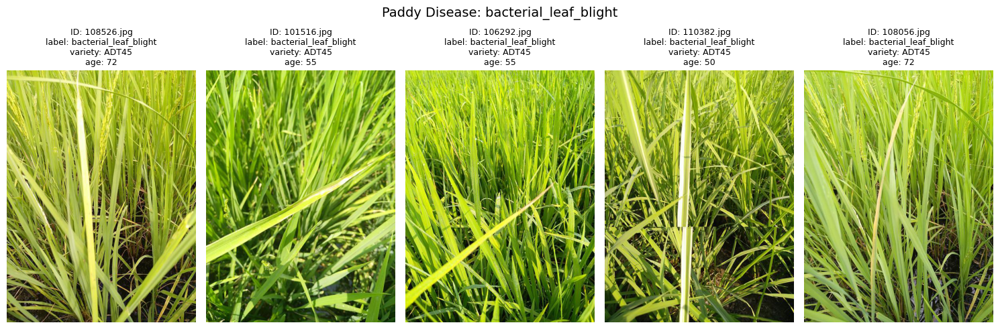

			+--------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_LEAF_STREAK`           |
			+--------------------------------------------------------------------+


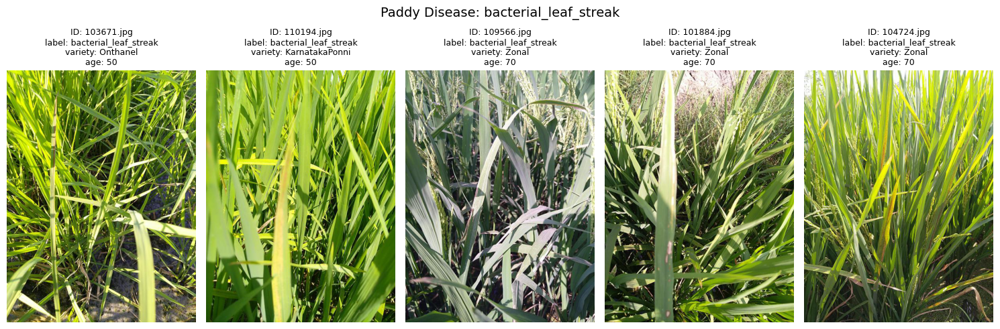

			+-----------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_PANICLE_BLIGHT`           |
			+-----------------------------------------------------------------------+


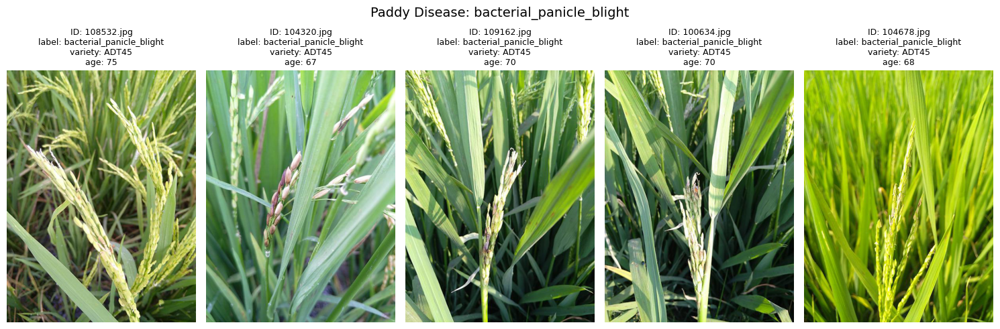

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BLAST`           |
			+----------------------------------------------------+


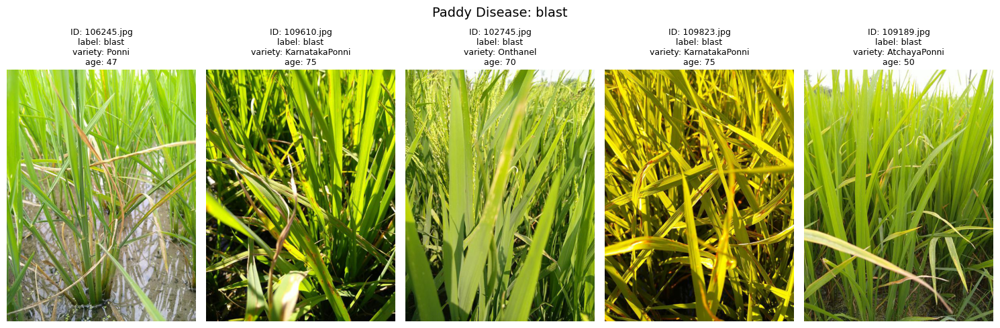

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BROWN_SPOT`           |
			+---------------------------------------------------------+


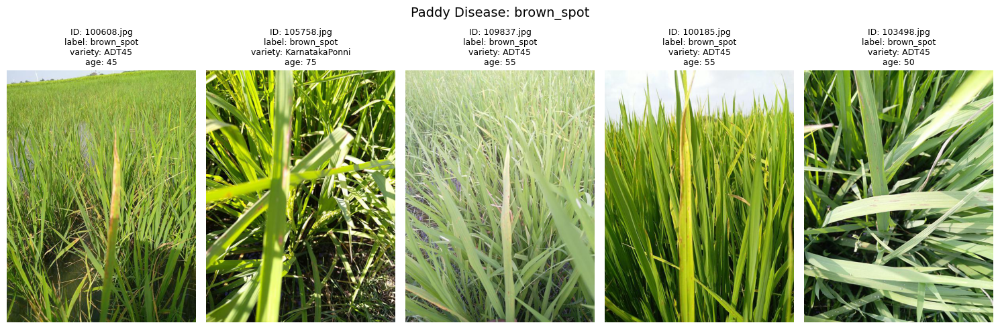

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `DEAD_HEART`           |
			+---------------------------------------------------------+


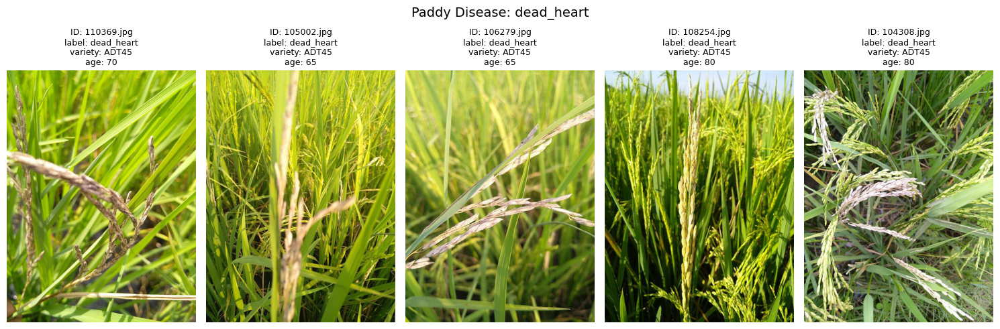

			+-----------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `DOWNY_MILDEW`           |
			+-----------------------------------------------------------+


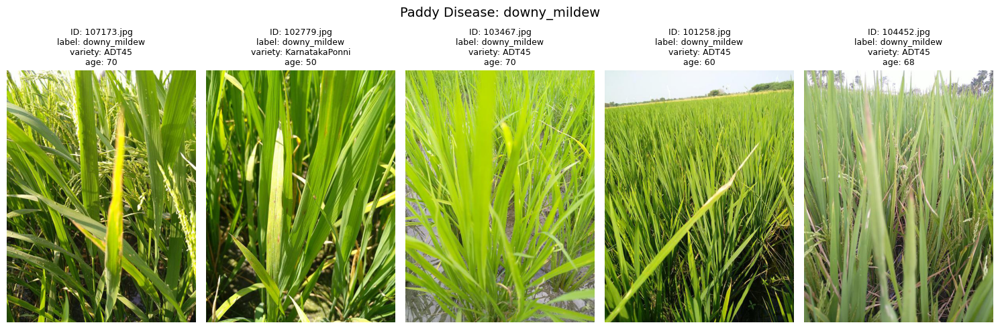

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `HISPA`           |
			+----------------------------------------------------+


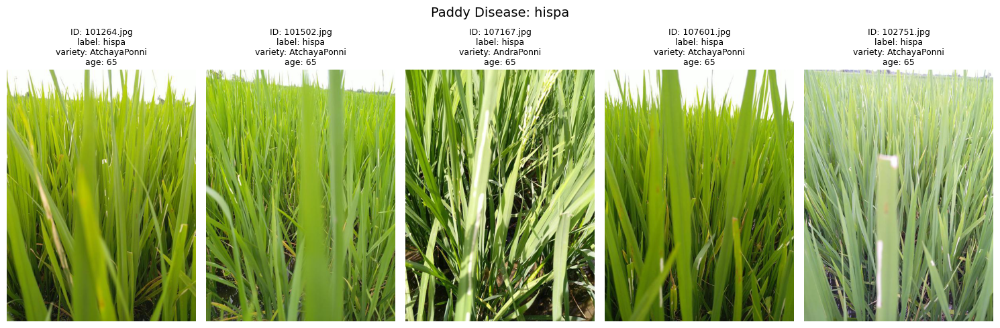

			+-----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `NORMAL`           |
			+-----------------------------------------------------+


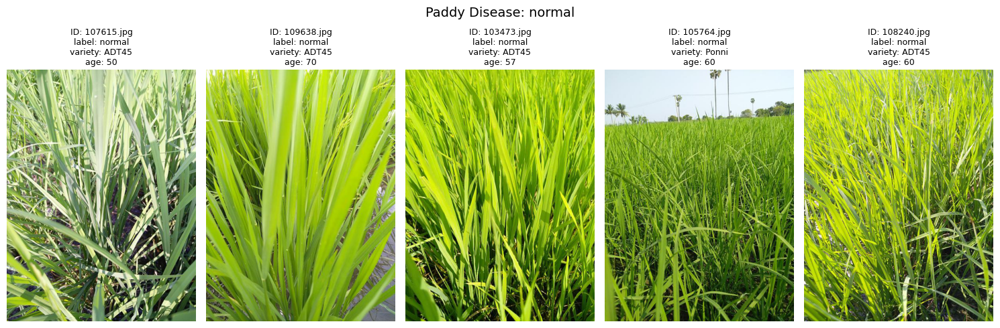

			+-----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `TUNGRO`           |
			+-----------------------------------------------------+


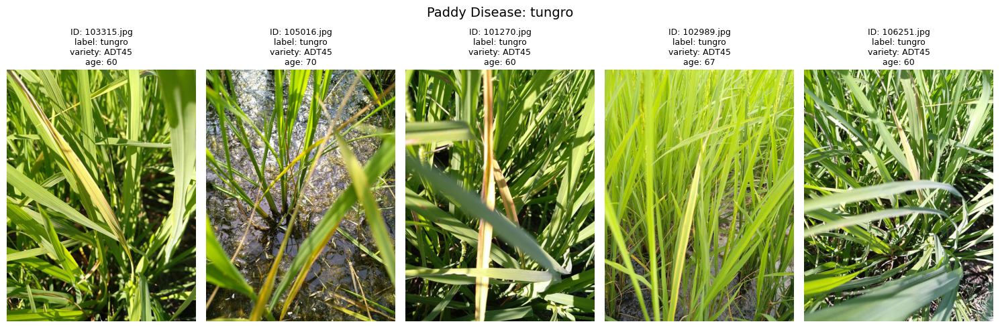

In [30]:
# List of directories for each label
labels = [
    "bacterial_leaf_blight",
    "bacterial_leaf_streak",
    "bacterial_panicle_blight",
    "blast",
    "brown_spot",
    "dead_heart",
    "downy_mildew",
    "hispa",
    "normal",
    "tungro",
]

# Base path for the image directories
base_path = "./inputs/train_images"

# Loop through each label directory and display images
for label in labels:
    directory = os.path.join(base_path, label)
    print_header(f"Visualizing Images for `{label}`", tabs=True)
    display_images(
        directory,
        num_images=5,
        metadata_df=clean_df,
        title=f"Paddy Disease: {label}",
        figsize=(15, 5),
    )

### 4.2) Variety Image Visualization

Note: Tạo lại function cho gọn


			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ADT45`           |
			+----------------------------------------------------+


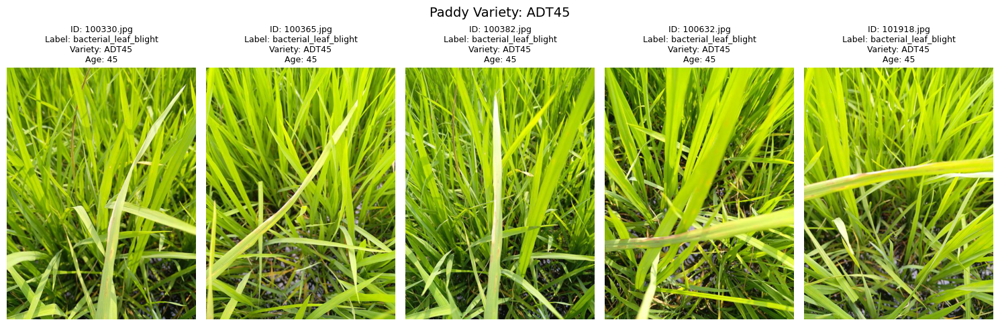

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ANDRAPONNI`           |
			+---------------------------------------------------------+


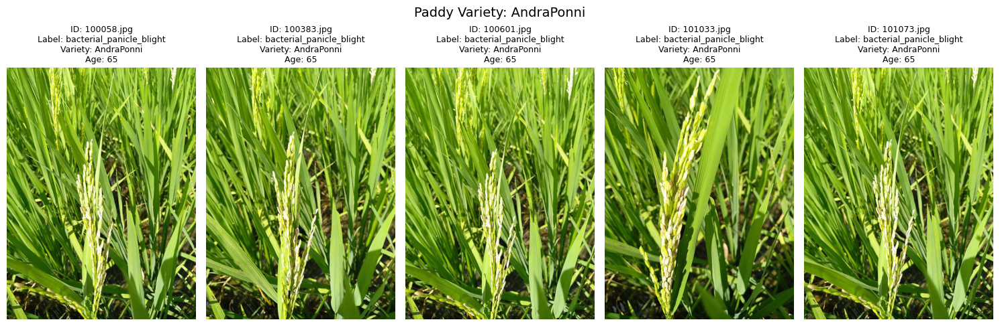

			+-----------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ATCHAYAPONNI`           |
			+-----------------------------------------------------------+


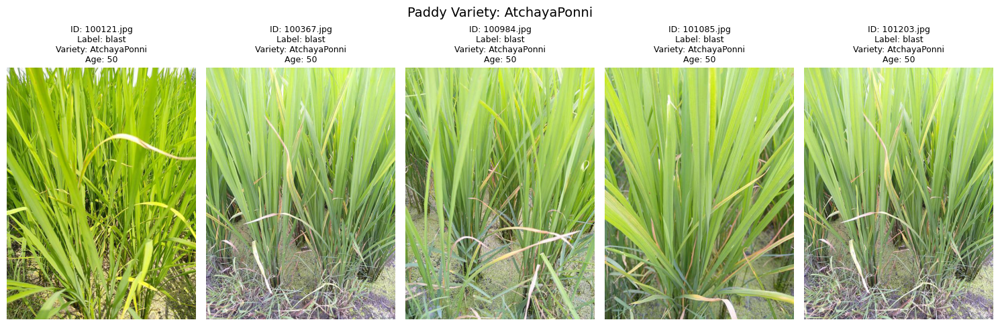

			+---------------------------------------------------+
			|           VISUALIZING IMAGES FOR `IR20`           |
			+---------------------------------------------------+


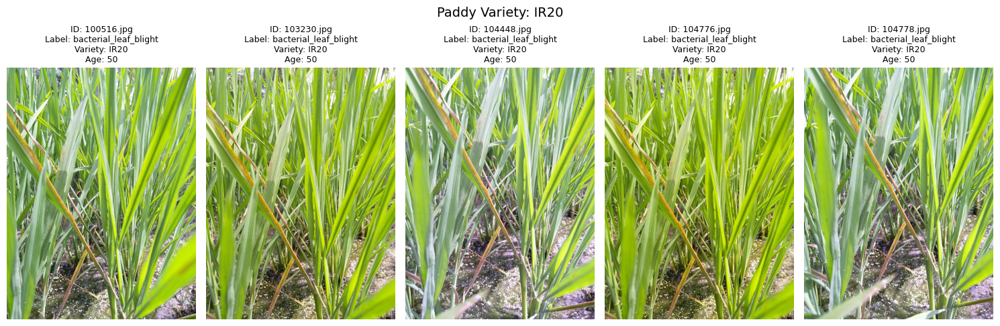

			+-------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `KARNATAKAPONNI`           |
			+-------------------------------------------------------------+


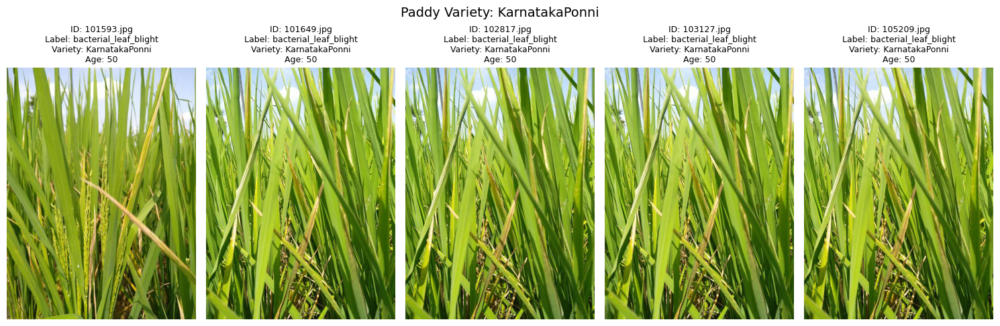

			+-------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ONTHANEL`           |
			+-------------------------------------------------------+


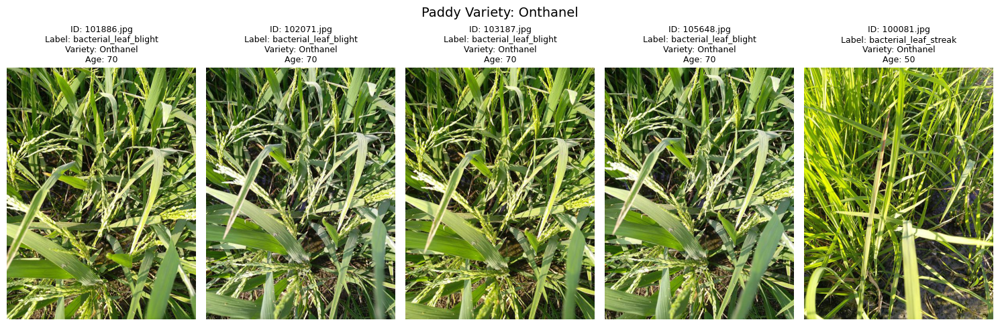

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `PONNI`           |
			+----------------------------------------------------+


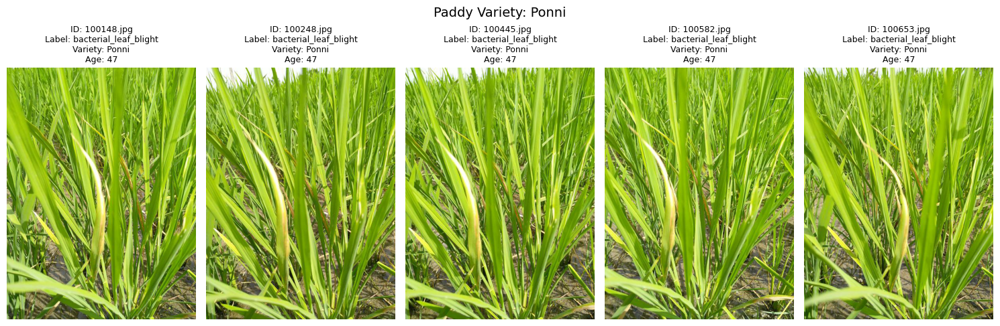

			+-------------------------------------------------+
			|           VISUALIZING IMAGES FOR `RR`           |
			+-------------------------------------------------+


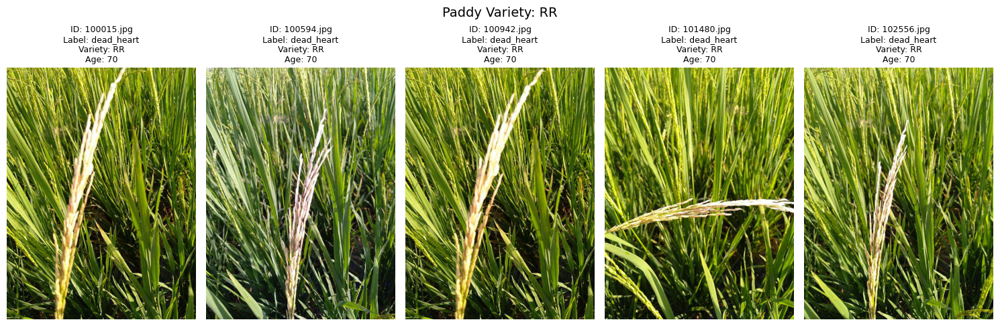

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `SURYA`           |
			+----------------------------------------------------+


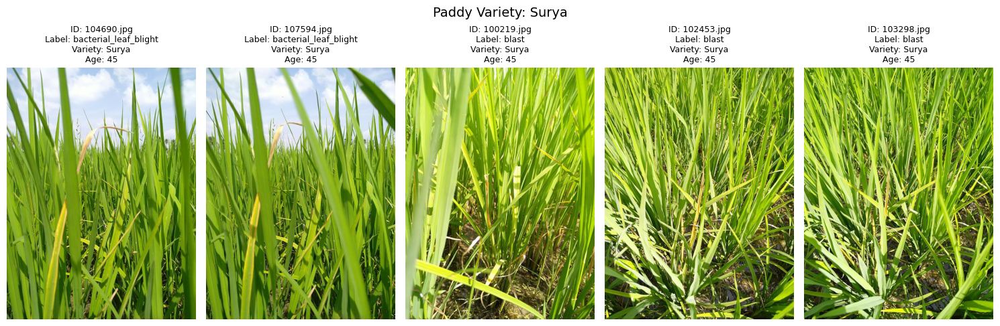

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ZONAL`           |
			+----------------------------------------------------+


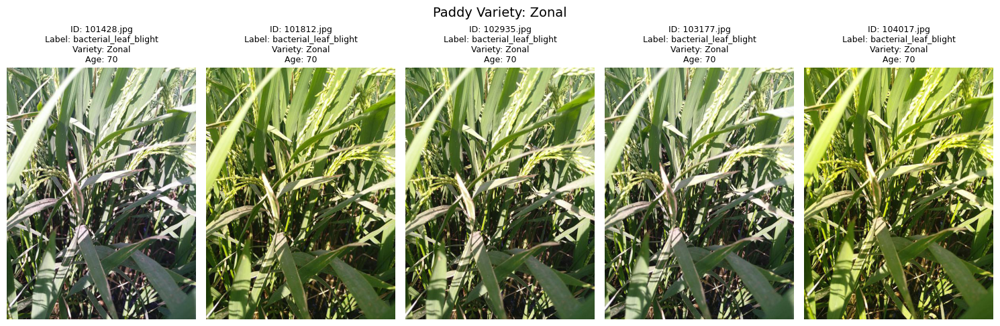

In [31]:
# Base path for the image directories
base_path = "./inputs/train_images"

# Group by 'variety' and select the first 5 image_id for each variety
variety_grouped = clean_df.groupby("variety")

# Loop through each variety
for variety, variety_df in variety_grouped:
    # Get the first 5 image_ids and their associated labels for the current variety
    variety_data = variety_df.head(5)[["image_id", "label", "age"]]

    # Construct the full paths for the images
    image_paths = [
        os.path.join(base_path, row["label"], row["image_id"])
        for _, row in variety_data.iterrows()
    ]

    # Print header for the variety
    print_header(f"Visualizing Images for `{variety}`", tabs=True)

    # Display the images
    fig, axes = plt.subplots(1, len(image_paths), figsize=(15, 5), facecolor="white")
    for idx, (image_path, row) in enumerate(zip(image_paths, variety_data.iterrows())):
        try:
            img = mpimg.imread(image_path)
            axes[idx].imshow(img)
            axes[idx].axis("off")

            # Extract details for title
            image_id = row[1]["image_id"]
            label = row[1]["label"]
            age = row[1]["age"]

            axes[idx].set_title(
                f"ID: {image_id}\nLabel: {label}\nVariety: {variety}\nAge: {age}",
                fontsize=9,
            )

        except FileNotFoundError:
            print(f"Image not found: {image_path}")

    plt.suptitle(f"Paddy Variety: {variety}", fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

## 5) Distribution (rename later)

### 5.1) Plot label distribution

The label distribution of the paddy disease introduces a moderately imbalanced dataset with some classes significantly more represented than others:

- `normal` is most represented, which occupied approximately 17.0% of the samples.

- `blast` (16.7%), `hispa` (15.3%), and `dead_heart`(13.9%) are the three most popular diseases in the captured paddy.

- Conversely, `bacterial_panicle_bight` (3.3%) and `bacterial_leaf_steak` (3.6%) are the least common, indicating a potential challenge for further models to learn from these minority classes.

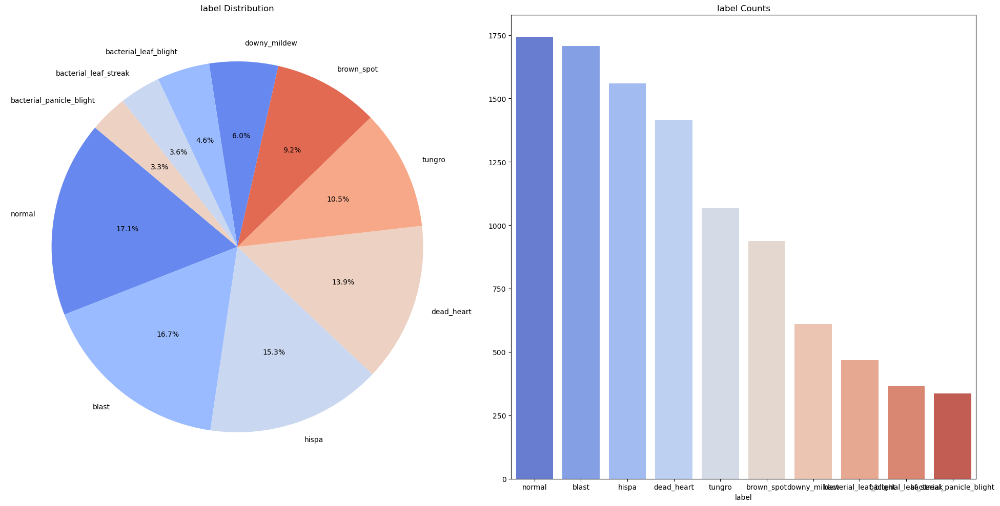

In [35]:
visualize_category_distribution(clean_df, 'label')

### 5.2) Plot Variety Distribution

The **variety distribution** shows the **highly** imbalanced, where `ADT45` is the dominant variety, accounting for more than half of the dataset at 67.3%. By contrast, `Surya` and `RR` occupied less than 1%. 

This significant dominance of a single variety (`ADT45`) is a huge challenge for model training, where the model will be biased toward this variety if there's no balancing technique applied.

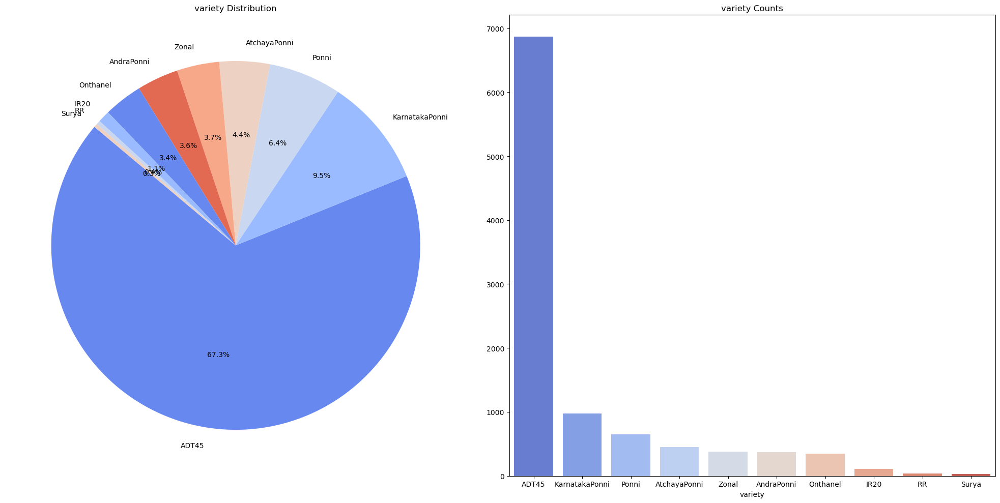

In [36]:
visualize_category_distribution(clean_df, 'variety')

### 5.3) Plot Age Distribution



The data distribution in the `age` column is slightly imbalanced:
- The most common age is `70` days which accounts for 29.6% of the dataset. `70` days is the average age of paddy plants in the reproductive phase, which is the most common growth stage for rice plants.
- The second most common age is `60` days which accounts for 16%
- The third most common age is `50` days which accounts for 10.2%
- The least common age is `62` days and `82` days accounting for less than 0.5%

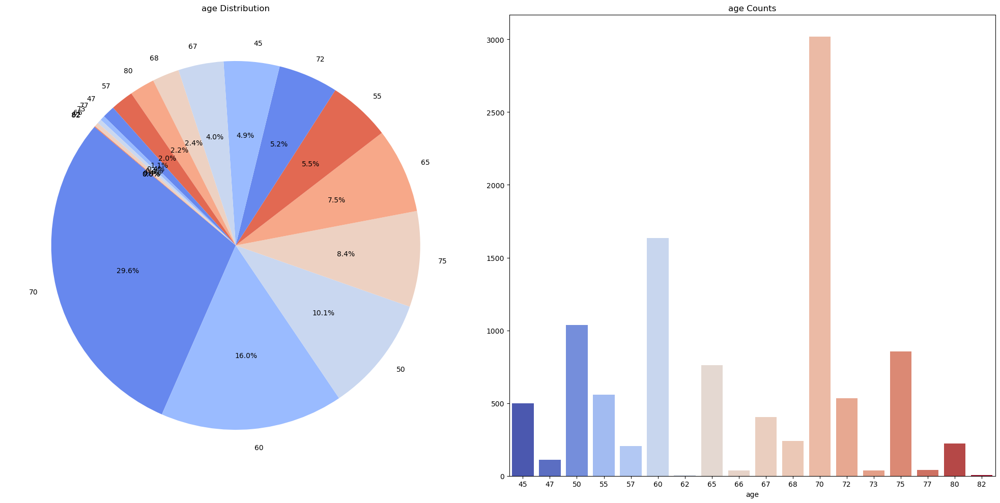

In [37]:
visualize_category_distribution(clean_df, 'age')

The age of each variety is quite approximately the same, with the exception of `Surya` which are younger than the other.
- `RR` is the variety with the biggest average age(around 70 days)
- `KarnatakaPonni` is the second biggest average age(around 69 days)
- `Zonal` is the third biggest average age(around 65 days)
- `Surya` is the variety with the smallest average age(around 45 days)

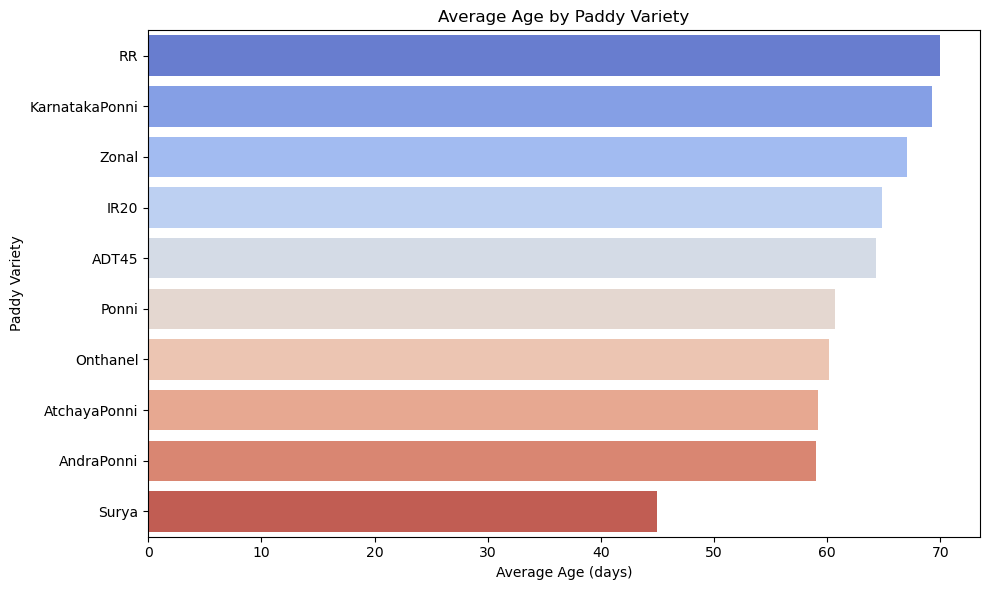

In [38]:
plot_grouped_bar(
    clean_df,
    group_col="variety",
    value_col="age",
    agg_func="mean",
    title="Average Age by Paddy Variety",
    x_label="Average Age (days)",
    y_label="Paddy Variety",
)

Gennerally, the majority of diseases appear in the range 60-70 days, which is the reproductive phase of paddy plants.
- `bacterial_leaf_blight` is the disease that appears latest which is around 70 days
- `dead_heart` and `brown_spot` are the diseases that appear second amd third latest which are 68 and 64 days respectively
- `downy_mildew` is the disease that appears earliest which is around 60 days

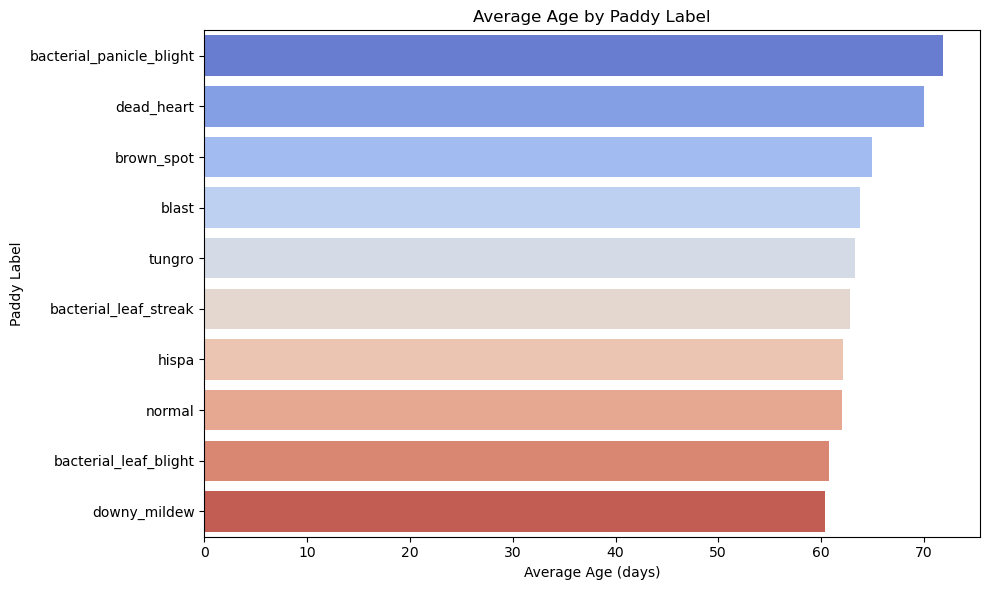

In [39]:
plot_grouped_bar(
    clean_df,
    group_col="label",
    value_col="age",
    agg_func="mean",
    title="Average Age by Paddy Label",
    x_label="Average Age (days)",
    y_label="Paddy Label",
)

### 5.4) Variety vs Label

Disease occurrence varies strongly by variety
- `ADT45` dominates the dataset with all types of labels, especially `normal`, `dead_heart`, `tungro`.
- `KarnatakaPonni` falls mainly into `blast` disease
- Other variety have sparse records. For instance, `RR`, and `Surya` have almost no disease record

(khúc này chưa para, khúc trên cũng nên cần para lại)
Specific diseases are concentrated in specific varieties

Diseases like tungro and hispa are heavily concentrated in ADT45.

Varieties like AndraPonni, AtchayaPonni, and Zonal have very few diseases overall.


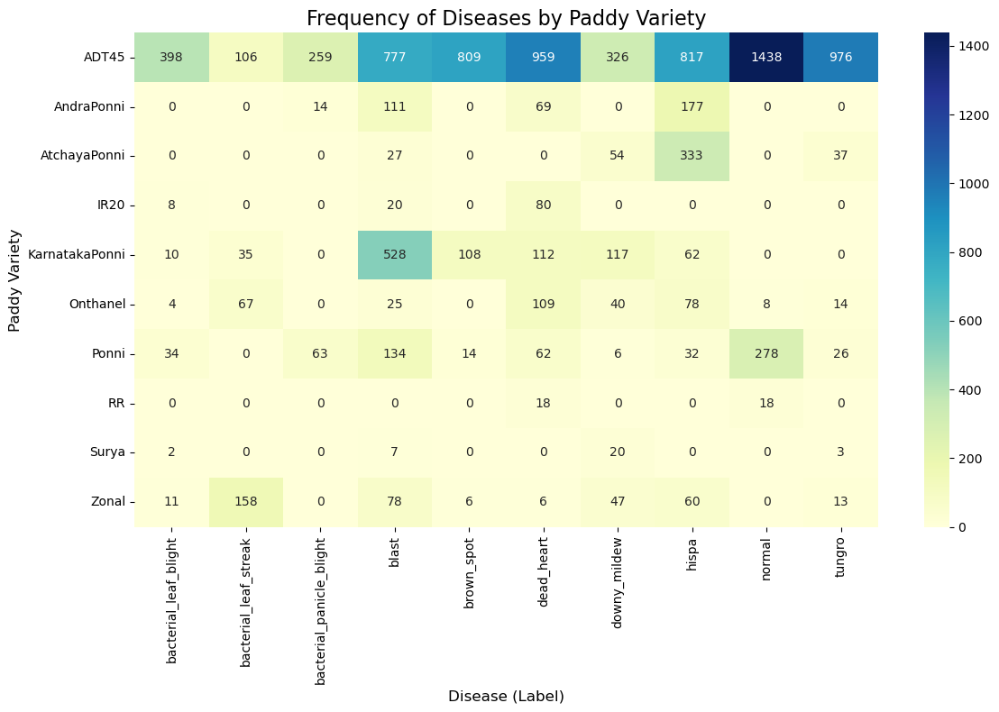

In [ ]:
variety_label_counts = (
    clean_df.groupby(["variety", "label"]).size().unstack(fill_value=0)
)

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(variety_label_counts, annot=True, fmt="d", cmap="YlGnBu", cbar=True)

# Add titles and labels
plt.title("Frequency of Diseases by Paddy Variety", fontsize=16)
plt.xlabel("Disease (Label)", fontsize=12)
plt.ylabel("Paddy Variety", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# IV. DATA PREPROCESSING

In [42]:
img_original_dir = "./inputs/train_images"
img_augmented_dir = "./inputs/augmented_images"

# Create directory
os.makedirs(img_augmented_dir, exist_ok=True)

# Augment underrepresented classes
target_varieties = clean_df["variety"].value_counts()
minor_varieties = target_varieties[target_varieties < 500].index

# Create new rows
new_rows = []
augmented_count = defaultdict(int)


for _, row in tqdm(clean_df.iterrows(), total=len(clean_df)):
    image_id, label, variety, age = (
        row["image_id"],
        row["label"],
        row["variety"],
        row["age"],
    )
    image_path = os.path.join(img_original_dir, label, f"{image_id}")

    if not os.path.exists(image_path):
        print(f"[WARNING] Missing image: {image_path}")
        continue

    image = cv2.imread(image_path)

    if image is None:
        print(f"[WARNING] Failed to load image: {image_path}")
        continue

    if variety in minor_varieties:
        for angle in [90, 180, 270]:
            rotated = cv2.rotate(
                image,
                {
                    90: cv2.ROTATE_90_CLOCKWISE,
                    180: cv2.ROTATE_180,
                    270: cv2.ROTATE_90_COUNTERCLOCKWISE,
                }[angle],
            )

            new_image_id = f"{image_id}_rot_{angle}"
            label_dir = os.path.join(img_augmented_dir, label)
            os.makedirs(label_dir, exist_ok=True)

            new_path = os.path.join(label_dir, f"{new_image_id}.jpg")

            # if the image file doesn't exists
            if not os.path.exists(new_path):
                cv2.imwrite(new_path, rotated)

            new_rows.append(
                {
                    "image_id": new_image_id,
                    "label": label,
                    "variety": variety,
                    "age": age,
                }
            )
            augmented_count[variety] += 1

# Save new metadata
augmented_df = pd.concat([clean_df, pd.DataFrame(new_rows)], ignore_index=True)
augmented_df.to_csv("./inputs/meta_train_augmented.csv", index=False)

100%|██████████| 10208/10208 [00:24<00:00, 422.37it/s]


In [43]:
print_header("Augmentation Summary per Variety:")
for variety, count in sorted(augmented_count.items(), key=lambda x: x[1], reverse=True):
    print(f"- {variety}: {count} new images")

+-------------------------------------------------------+
|           AUGMENTATION SUMMARY PER VARIETY:           |
+-------------------------------------------------------+
- AtchayaPonni: 1353 new images
- Zonal: 1137 new images
- AndraPonni: 1113 new images
- Onthanel: 1035 new images
- IR20: 324 new images
- RR: 108 new images
- Surya: 96 new images


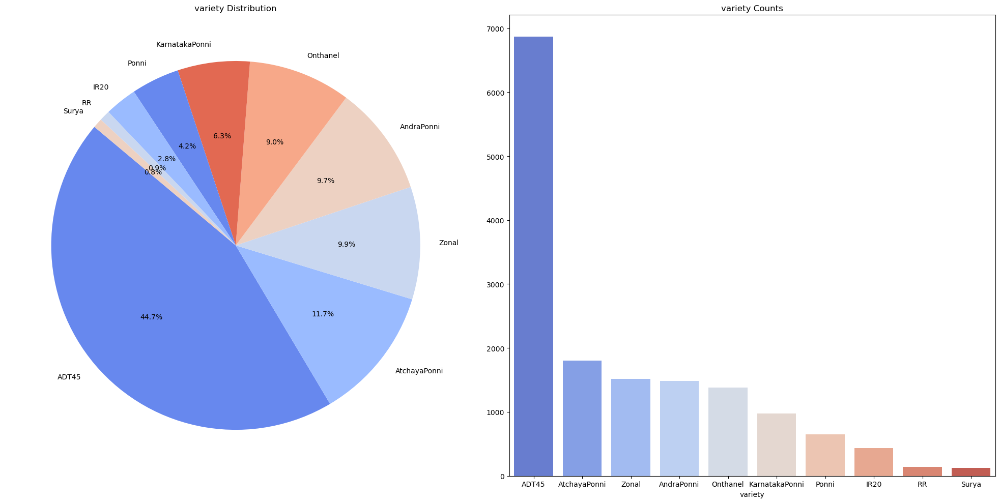

In [44]:
visualize_category_distribution(augmented_df, "variety")

THIẾU IN RA NHỮNG TẤM MỚI SỬA

In [45]:
len(augmented_df)

15374